Import modules

In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler
import pandas_profiling
from scipy import stats


Import data

In [3]:
homes = pd.read_csv('Sold_Home_Data_Cleaned_v2.csv')

Check data types

In [18]:
homes.dtypes

Unnamed: 0                    int64
City                         object
ZIP 5                       float64
ZIP 4                       float64
MLS ID                        int64
Listing Type                 object
List Price                    int64
Days on Market              float64
Township Name                object
Subdivision                  object
Tax Amount                  float64
Total Market Value            int64
Market Value Land             int64
Market Value Improvement      int64
Estimated Value             float64
County Use Code              object
Universal Land Use           object
Lot Acres                   float64
Lot SQFT                    float64
New Construction             object
Beds                        float64
Baths                       float64
Total Building Area           int64
Living Area SQFT            float64
Garage SQFT                 float64
Basement                     object
Flooring Cover               object
Stories                     

In [4]:
homes = homes.drop(['Total Units', 'List Price per SQFT', 'Sale Price per SQFT', 'Sales/List Ratio', 'Mortgage 1 Rate', 'Mortgage 1 Amount', 'Equity Percentage', 'Equity', 'Lot Acres', 'Universal Land Use','MLS ID', 'Exterior Wall', 'Roof Material Type'], axis=1)

In [5]:
homes = homes.drop(['Parking Type'], axis=1)

In [6]:
homes = homes.drop(['Unnamed: 0', 'Construction Type'], axis=1)

In [7]:
homes = homes.drop(['Flooring Cover'], axis=1)

In [64]:
#homes['Stories'].head(50)

turn object variables into numbers

In [8]:
homes['ZIP 5'] = homes['ZIP 5'].astype(str)
homes['ZIP 4'] = homes['ZIP 4'].astype(str)
homes['ZIP 4'].head()

0    4036.0
1    5910.0
2    5162.0
3    4614.0
4    4031.0
Name: ZIP 4, dtype: object

In [103]:
#homes['Has Pool'] = homes['Has Pool'].replace('None',0)
#homes['Has Pool'] = homes['Has Pool'].replace('Pool (yes)',1)
#homes['Has Pool'] = homes['Has Pool'].replace('Pool & Spa (both)',2)
#homes['Has Pool'] = homes['Has Pool'].replace('Spa or Hot Tub (only)',3)
#homes['Has Pool'].head(50)

In [105]:
#homes['Porch Type'].head(50)
#homes['Porch Type'] = homes['Porch Type'].replace('None',0)
#homes['Porch Type'] = homes['Porch Type'].replace('Porch - Open',1)
#homes['Porch Type'] = homes['Porch Type'].replace('Porch',1)
#homes['Porch Type'] = homes['Porch Type'].replace('Porch covered',2)
#homes['Porch Type'].head(50)

In [106]:
#homes['Has Pool'] = homes['Has Pool'].astype(int)
#homes['Porch Type'] = homes['Porch Type'].astype(int)

In [107]:
homes.dtypes

City                         object
ZIP 5                        object
ZIP 4                        object
Listing Type                 object
List Price                    int64
Days on Market              float64
Township Name                object
Subdivision                  object
Tax Amount                  float64
Total Market Value            int64
Market Value Land             int64
Market Value Improvement      int64
Estimated Value             float64
County Use Code              object
Lot SQFT                    float64
New Construction             object
Beds                        float64
Baths                       float64
Total Building Area           int64
Living Area SQFT            float64
Garage SQFT                 float64
Basement                     object
Stories                      object
Year Built                  float64
Air conditioning             object
Heat Type                    object
Fireplace indicator            bool
Porch Type                  

In [9]:
homes.to_csv('EDA_Output')

Overview plots to look for correlations

<AxesSubplot:>

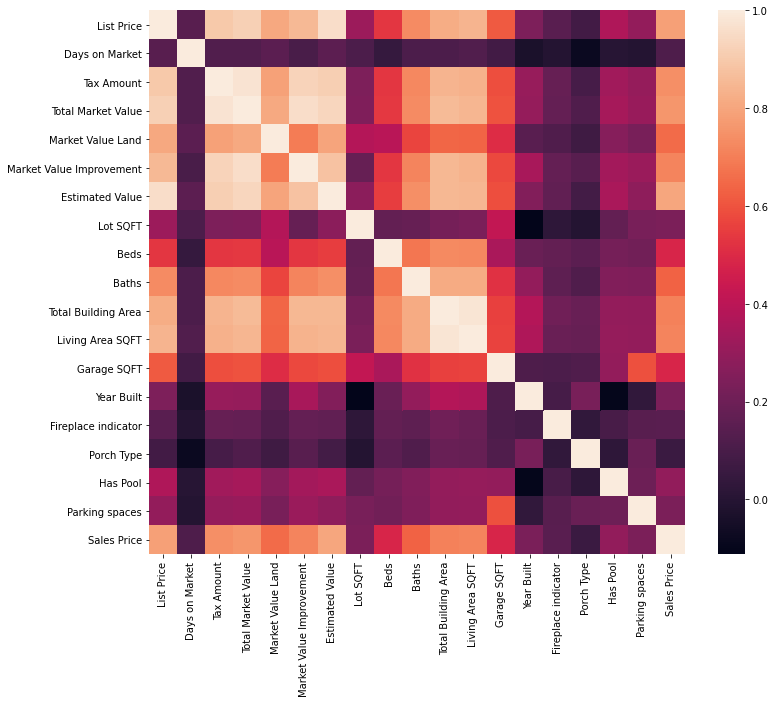

In [108]:
plt.subplots(figsize=(12,10))
sns.heatmap(homes.corr())

Pandas Profiles to look at all of the individual variables

In [109]:
report = homes.profile_report(sort=None, html={'style':{'full_width': True}}, progress_bar=False)
report

Looking at which features correlate with the sale price target variable

In [110]:
def scatterplots(columns, ncol=None, figsize=(15, 8)):
    if ncol is None:
        ncol = len(columns)
    nrow = int(np.ceil(len(columns) / ncol))
    fig, axes = plt.subplots(nrow, ncol, figsize=figsize, squeeze=False)
    fig.subplots_adjust(wspace=0.5, hspace=0.6)
    for i, col in enumerate(columns):
        ax = axes.flatten()[i]
        ax.scatter(x = col, y = 'Sales Price', data=homes, alpha=0.5)
        ax.set(xlabel=col, ylabel='Sales Price')
    nsubplots = nrow * ncol    
    for empty in range(i+1, nsubplots):
        axes.flatten()[empty].set_visible(False)

In [111]:
features = [x for x in homes.columns if x not in ['Sales Price']]

scatterplots(features, ncol=4, figsize=(15, 15))

TypeError: 'value' must be an instance of str or bytes, not a float

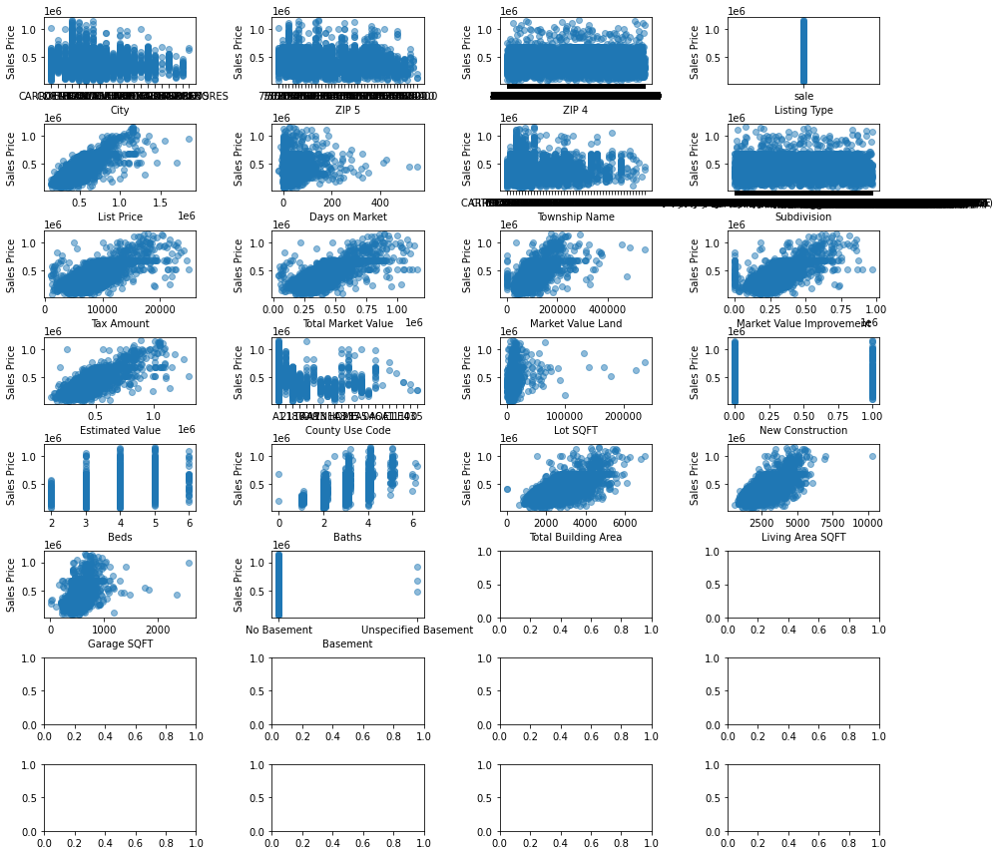

In [112]:
scatterplots(features, ncol=4, figsize=(15, 15))

After looking through all of the variables it seems a little unfair to use some of them due to colinearity. The features that may be removed are Tax Amount, Total Market Value, Market Value Land, Market Value Improvement, and Estimated Value

The home features that seem interesting to go forward with are Beds, Baths, Total Building Area, Living Area SQFT, Garage SQFT. 

It would also be interesting to run models to see if you could predict sales price mainly from location rather than home features. These would include City, ZIP 5, ZIP 4, Township Name and Subdivision